This script takes the dfs (for all relative abundance thresholds of 0%, 0.001%, 0.01%, 0.1%, and 1%) from refraction it into two parts (tersh).
- The tersh method divides the FASTQ files into subsamples (sample length dependant) and calculates the distance (jaccard and brey-curtis) for each of the depths. 

In [1]:
import pandas as pd
import numpy as np
import os
import glob
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
from matplotlib.cm import ScalarMappable 
from matplotlib.lines import Line2D 
import matplotlib.patches as mpatches 
from matplotlib.patches import Patch
import matplotlib.lines as mlines
from textwrap import wrap 
from mpl_toolkits.axes_grid1.inset_locator import inset_axes 
from scipy.stats import linregress
import logging
logging.getLogger('matplotlib').setLevel(logging.ERROR)

In [2]:
path_mp4_files = os.path.expanduser("/data1/Oded.Sabah/metaanalysis/Rarefaction_out/")
csv_files = glob.glob(os.path.join(path_mp4_files, '**', '*.csv'), recursive=True)

df_dict_thresh = {}
df_dict_split = {}

for file in csv_files:
    id_file = file.split("/")[-2]
    thresh_file = file.split("_")[-1].rstrip('.csv')
    process_type = file.split("_")[-2]

    # Read csv file into dataframe
    df = pd.read_csv(file)  

    # Add id_file as a column in the dataframe
    df['id_file'] = id_file
    df['thresh_file'] = thresh_file
    df["process_type"] = process_type

    # Change the index for dataframes where process_type == 'trash'
    if process_type == 'thresh' and "index" in df.columns:
        df["index"] = [index.split(".")[-1] for index in df["index"]]
    # Set id_file as the index of the dataframe
    df.set_index('id_file', inplace=True)

    # Create a key for the dictionary
    key_thresh = (id_file, thresh_file, process_type)

    # If key exists, append the data. Otherwise, store this df in dictionary.
    if key_thresh in df_dict_thresh:
        df_dict_thresh[key_thresh] = pd.concat([df_dict_thresh[key_thresh], df], ignore_index=True)
    else:
        df_dict_thresh[key_thresh] = df

    # Change the index for dataframes where process_type == 'trash'
    if process_type == 'split' and "index" in df.columns:
        df['group'] = df['index'].str.split('-').str[2]
        group = df['group'].iloc[0]

    key_split = (id_file, thresh_file, process_type)

    if key_split in df_dict_split:
        df_dict_split[key_split] = pd.concat([df_dict_split[key_split], df], ignore_index=True)
    else:
        df_dict_split[key_split] = df

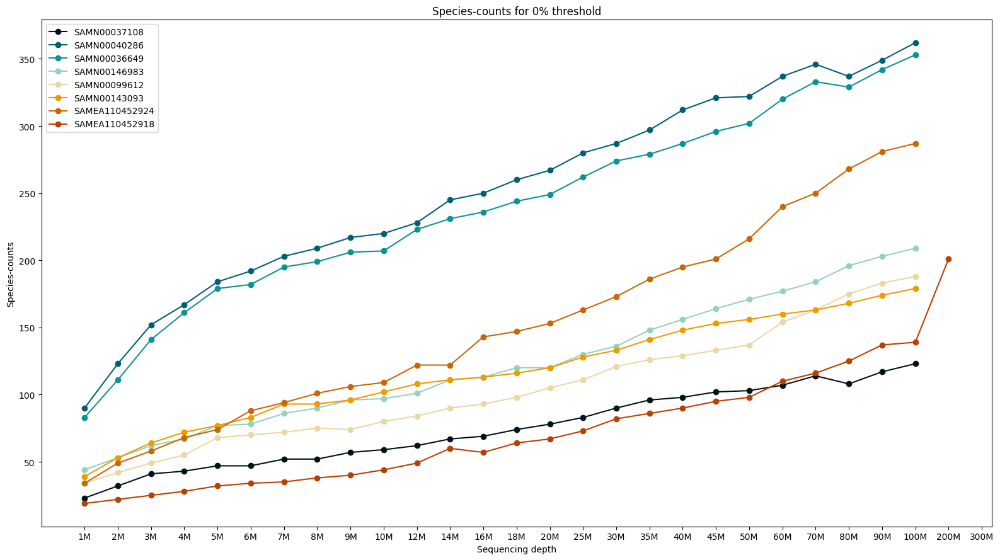

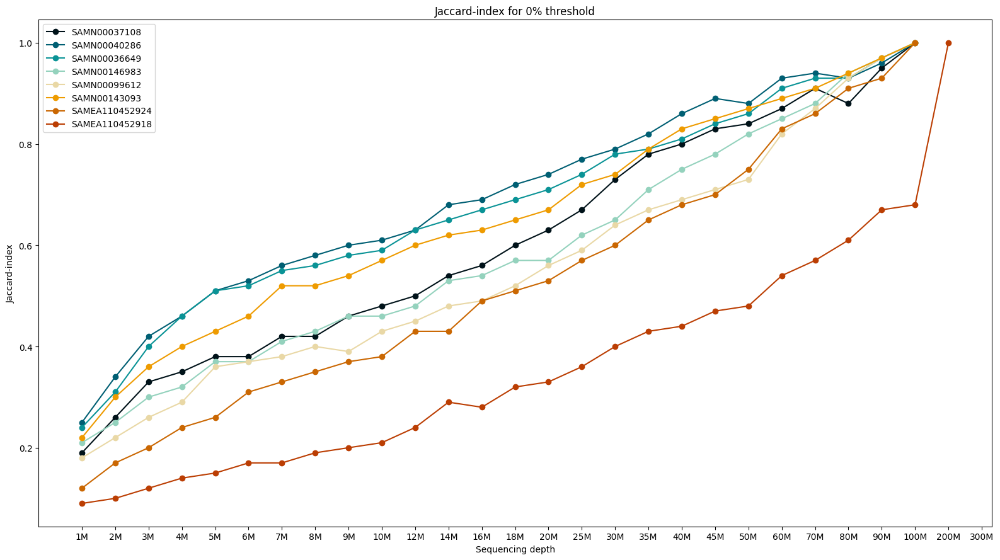

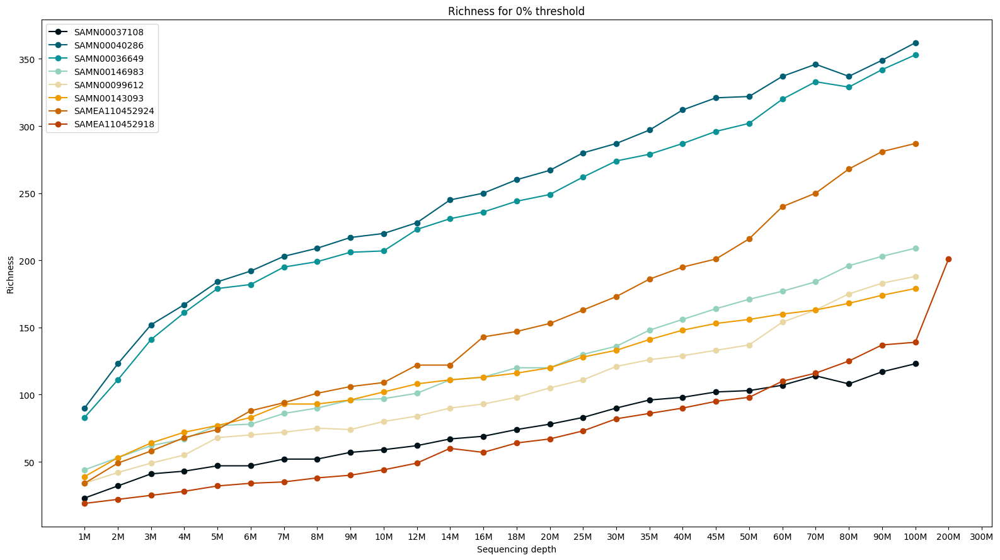

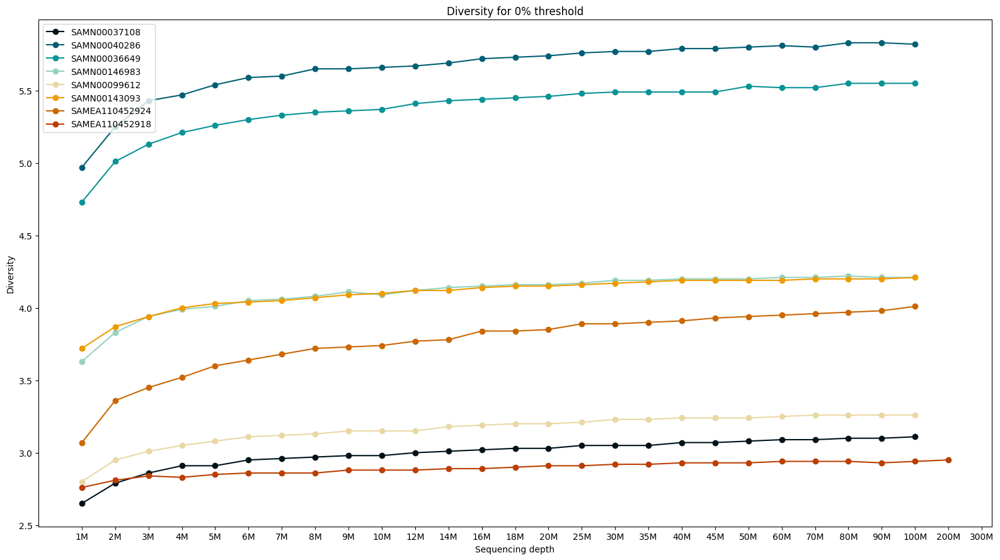

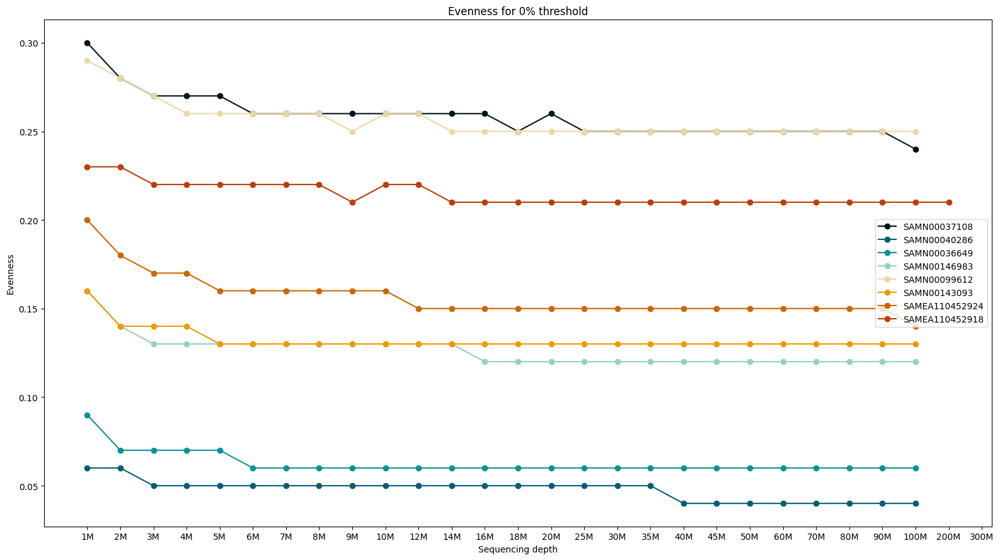

...

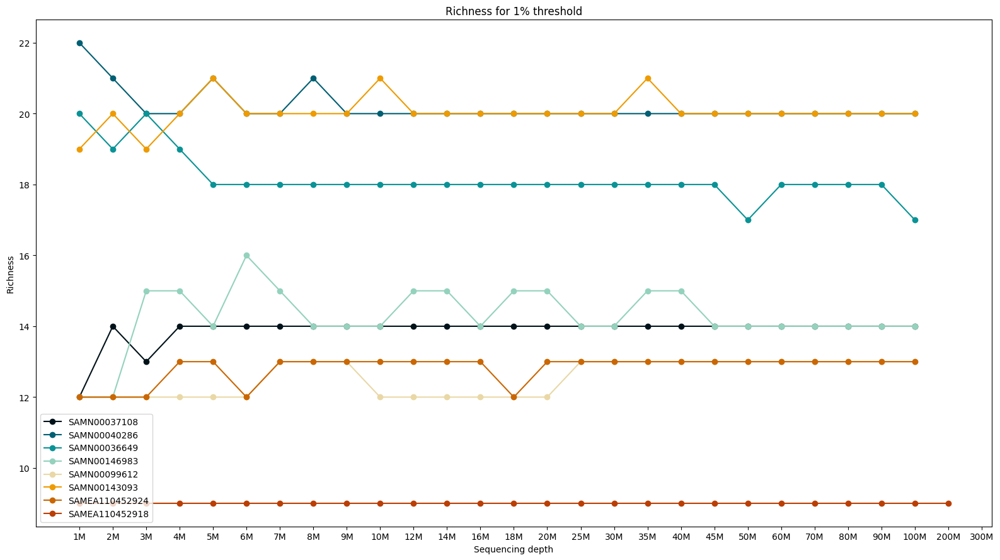

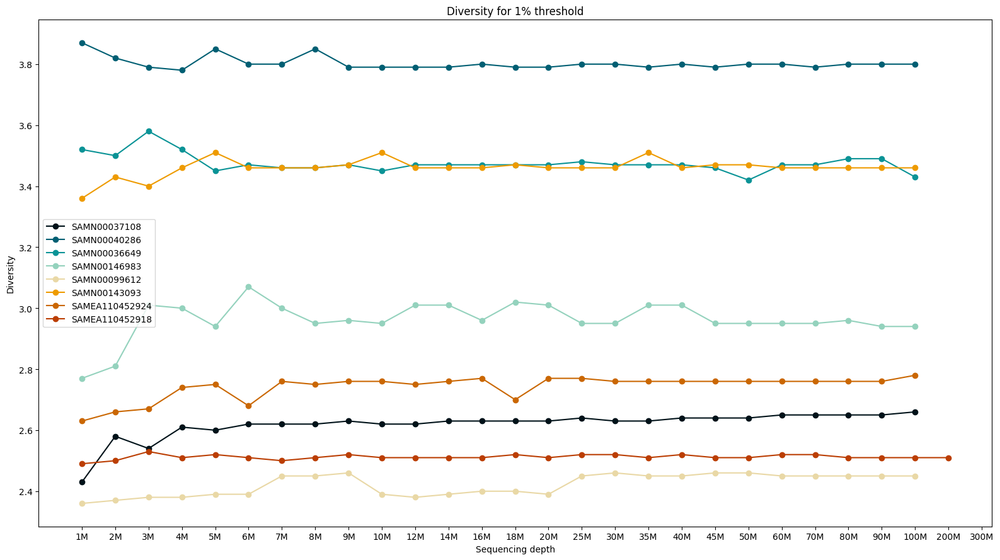

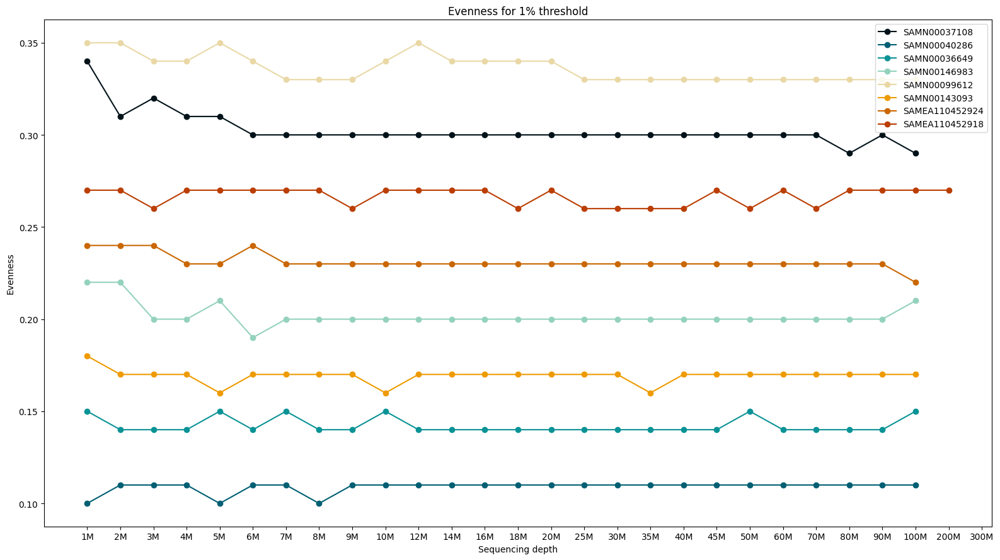

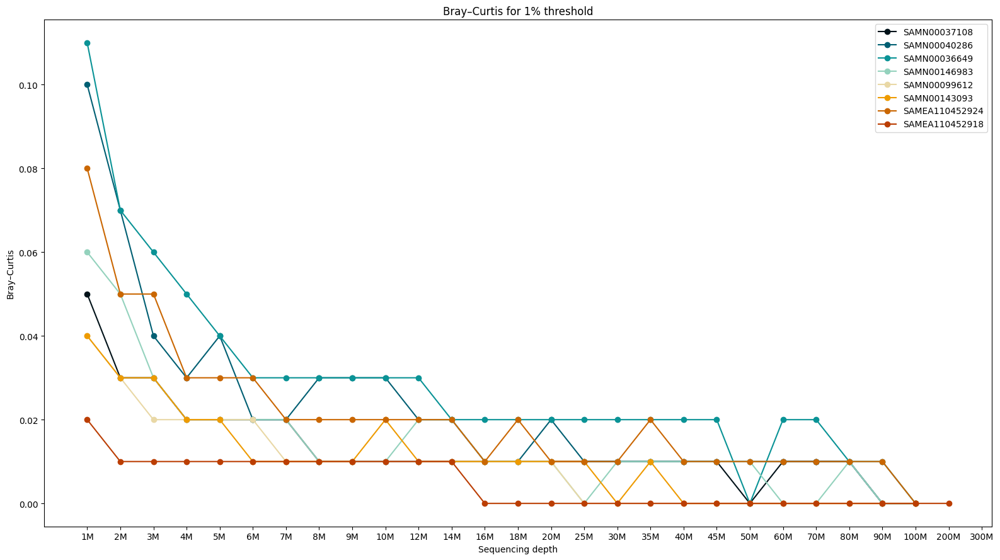

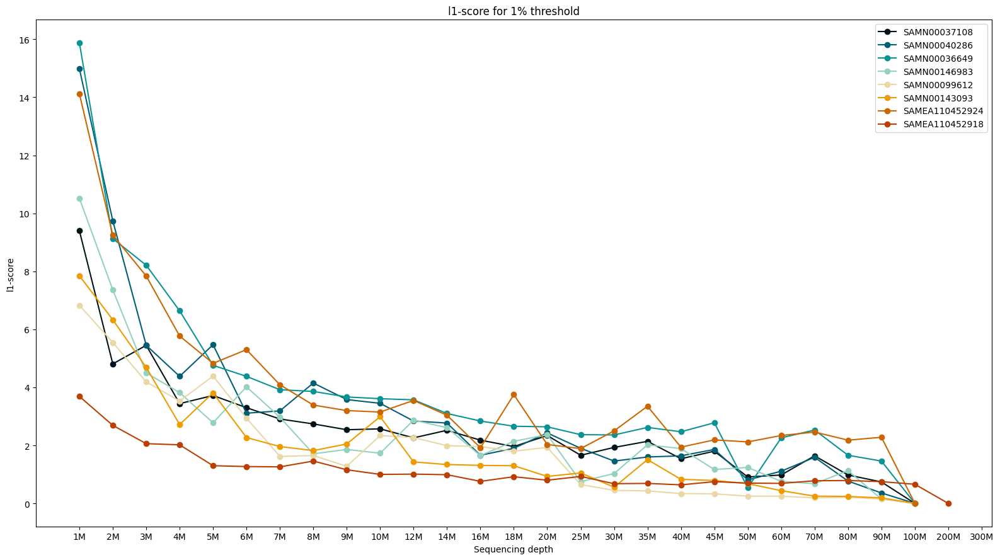

In [4]:
COLORS = ["#001219","#005f73","#0a9396","#94d2bd","#e9d8a6","#ee9b00","#ca6702","#bb3e03","#ae2012","#9b2226"]

thresholds = [0, 0.001, 0.01, 0.1, 1]
columns = df.columns[1:8]  # update this to match your data
ylabel = ['Species-counts','Jaccard-index','Richness','Diversity', 'Evenness', 'Bray–Curtis', 'l1-score', 'l2-score']

# Loop over each threshold
for threshold in thresholds:
    # Loop over each column
    for i, column in enumerate(columns):
        # Initialize figure and axes for each plot
        fig, ax = plt.subplots(figsize=(16,9), dpi= 100)

        new_array = np.array(np.append(df['index'].values[::], ["300M"]))

        color_idx = 0  # Initialize a color index to cycle through the COLORS list

        for key, df in df_dict_thresh.items():
            if (df["process_type"] == 'thresh').any() and (df["thresh_file"] == str(threshold)).any():
                ax.plot(df['index'], df[column], label=key[0], marker='o', color=COLORS[color_idx % len(COLORS)])  # Use color from COLORS list
                color_idx += 1  # Increment color index
        
        # Set xticks with labels
        ax.set_xticks(range(len(new_array)))  # Set xticks as range of new_array length
        ax.set_xticklabels(new_array, rotation=0)  # Set xtick labels as 'new_array' values
        
        # Set plot title, x-axis and y-axis labels
        ax.set_title(f'{ylabel[i]} for {threshold}% threshold')
        ax.set_xlabel('Sequencing depth')
        ax.set_ylabel(ylabel[i])

        # Add a legend to the plot
        ax.legend()

        # Display the plot
        plt.tight_layout()
        plt.show()


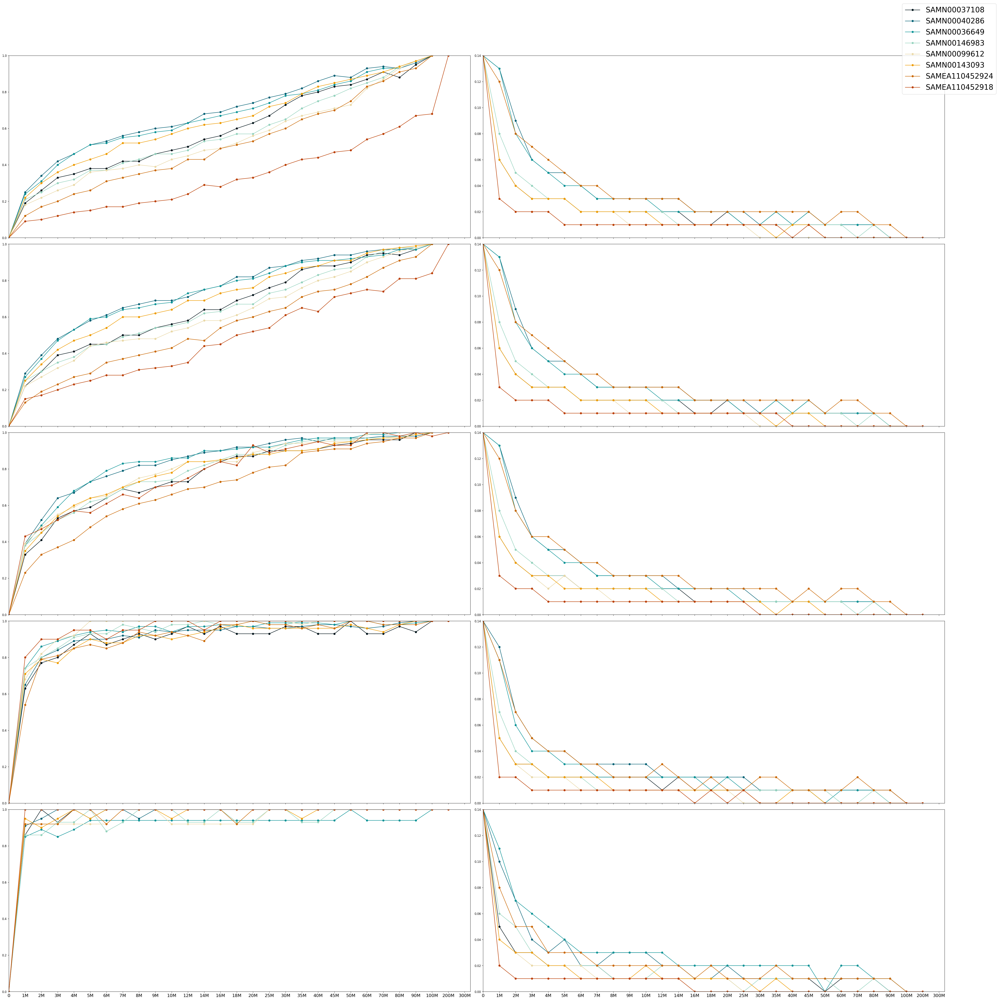

In [19]:
COLORS = ["#001219","#005f73","#0a9396","#94d2bd","#e9d8a6","#ee9b00","#ca6702","#bb3e03","#ae2012","#9b2226"]
thresholds = [0, 0.001, 0.01, 0.1, 1]

actual_column_names = ['Ground_truth', 'Dissimilarity']
ylabel = ['Similarity', 'Dissimilarity']
columns = df[actual_column_names]  # Select the actual columns

# Create zero_row and one_row
zero_row = pd.DataFrame({col: 0 if col != 'index' else "0" for col in df.columns}, index=[0])
one_row = pd.DataFrame({col: 0.14 if col != 'index' else "0.14" for col in df.columns}, index=[0])

fig, axs = plt.subplots(len(thresholds), len(actual_column_names), figsize=(50, 10*len(thresholds)), dpi=120, frameon=False)

legend_labels = []  # List to store labels for legend

# Loop over each threshold
for t_idx, threshold in enumerate(thresholds):
    # Loop over each column
    for c_idx, column in enumerate(columns):
        ax = axs[t_idx, c_idx]  # Select the correct subplot
        color_idx = 0  # Initialize the color index here

        # Loop over each DataFrame in the dictionary
        for key, current_df in df_dict_thresh.items():
            if (current_df["process_type"] == 'thresh').any() and (current_df["thresh_file"] == str(threshold)).any():
                # Decide which row to use based on the column
                if column == 'Ground_truth':
                    modified_column = pd.concat([zero_row[[column]], current_df[[column]].reset_index(drop=True)], ignore_index=True)
                else:  # column == 'Dissimilarity'
                    modified_column = pd.concat([one_row[[column]], current_df[[column]].reset_index(drop=True)], ignore_index=True)

                modified_index = pd.concat([zero_row[['index']], current_df[['index']].astype(str).reset_index(drop=True)], ignore_index=True)
                ax.plot(modified_index['index'], modified_column[column], marker='o', color=COLORS[color_idx % len(COLORS)])
                color_idx = (color_idx + 1) % len(COLORS)

                if t_idx == 0 and c_idx == 0:  # Save the labels only once
                    legend_labels.append(key[0])

        new_array = np.array(np.append(modified_index['index'].values[::], ["300M"]))
        ax.set_xticks(range(len(new_array)))
        ax.set_xticklabels(new_array, rotation=0)
        #ax.set_xlabel('Sequencing depth')
        #ax.set_ylabel(ylabel[c_idx])
        ax.set_ylim(bottom=0, top=0.14 if c_idx == 1 else 1)
        ax.set_xlim(left=0)
        # Set x-axis labels only for the last row
        if t_idx < len(thresholds) - 1:
            ax.set_xticklabels([])
        else:
            ax.set_xticks(range(len(new_array)))
            ax.set_xticklabels(new_array, rotation=0, fontsize=15)
        
        # if t_idx == 0:
        #     if c_idx == 0:
        #         ax.set_title('Similarity', fontsize=40, fontname='Bookman Old Style')
        #     elif c_idx == len(actual_column_names) - 1:
        #         ax.set_title('Dissimilarity', fontsize=40, fontname='Bookman Old Style')

# Adding a general title for all the plots
#plt.suptitle('Comparative Analysis Across Thresholds with Jaccard index and Bray-curtis', fontsize=55)
plt.subplots_adjust(hspace=0, wspace=0)

# Adding the legend outside of the plots
fig.legend(labels=legend_labels, loc='upper right', fontsize=25)

plt.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])  # Adjust layout to accommodate title and legend
plt.savefig('/home/odeds/metaanalysis/Rarefaction/Code/CALCULATE_THRESHOLD/compare_beta.png', format='png', dpi=100)


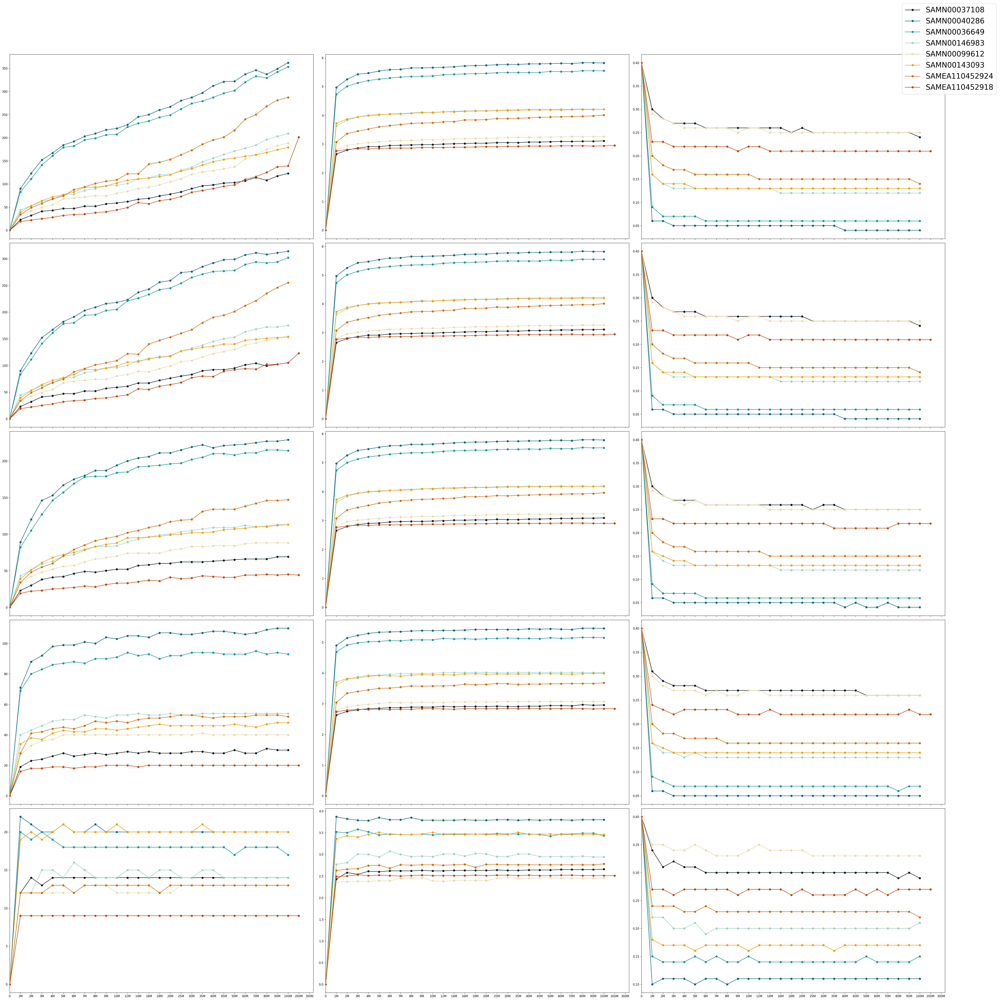

In [23]:
actual_column_names = ['Richness', 'Diversity', "Evenness"]
ylabel = ['Cho-1', 'Richness', "Evenness"]
columns = df[actual_column_names]  # Select the actual columns

# Create zero_row and one_row
zero_row = pd.DataFrame({col: 0 if col != 'index' else "0" for col in df.columns}, index=[0])
one_row = pd.DataFrame({col: 0.4 if col != 'index' else "0.4" for col in df.columns}, index=[0])

fig, axs = plt.subplots(len(thresholds), len(actual_column_names), figsize=(50, 10*len(thresholds)), dpi=120, frameon=False)

legend_labels = []  # List to store labels for legend

# Loop over each threshold
for t_idx, threshold in enumerate(thresholds):
    # Loop over each column
    for c_idx, column in enumerate(columns):
        ax = axs[t_idx, c_idx]  # Select the correct subplot
        color_idx = 0  # Initialize the color index here

        # Loop over each DataFrame in the dictionary
        for key, current_df in df_dict_thresh.items():
            if (current_df["process_type"] == 'thresh').any() and (current_df["thresh_file"] == str(threshold)).any():
                # Decide which row to use based on the column
                if column in ['Richness', 'Diversity']:
                    modified_column = pd.concat([zero_row[[column]], current_df[[column]].reset_index(drop=True)], ignore_index=True)
                else:  # column == 'Evenness'
                    modified_column = pd.concat([one_row[[column]], current_df[[column]].reset_index(drop=True)], ignore_index=True)

                modified_index = pd.concat([zero_row[['index']], current_df[['index']].astype(str).reset_index(drop=True)], ignore_index=True)
                ax.plot(modified_index['index'], modified_column[column], marker='o', color=COLORS[color_idx % len(COLORS)])
                color_idx = (color_idx + 1) % len(COLORS)

                if t_idx == 0 and c_idx == 0:  # Save the labels only once
                    legend_labels.append(key[0])

        new_array = np.array(np.append(modified_index['index'].values[::], ["300M"]))
        ax.set_xticks(range(len(new_array)))
        ax.set_xticklabels(new_array, rotation=0)
        #ax.set_xlabel('Sequencing depth')
        #ax.set_ylabel(ylabel[c_idx])
#         ax.set_ylim(bottom=0, top=0.14 if c_idx == 1 else 1)

        ax.set_xlim(left=0)
        # Set x-axis labels only for the last row
        if t_idx < len(thresholds) - 1:
            ax.set_xticklabels([])
        else:
            ax.set_xticks(range(len(new_array)))
            ax.set_xticklabels(new_array, rotation=0, fontsize=10)
        # if t_idx == 0:
        #     ax.set_title(ylabel[c_idx], fontsize=40)

# Adding a general title for all the plots
#plt.suptitle('Comparative Analysis Across Thresholds with Shannon, Chao1 and Simpson', fontsize=55)
plt.subplots_adjust(hspace=0, wspace=0)

# Adding the legend outside of the plots
fig.legend(labels=legend_labels, loc='upper right', fontsize=25)

plt.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])  # Adjust layout to accommodate title and legend
plt.savefig('/home/odeds/metaanalysis/Rarefaction/Code/CALCULATE_THRESHOLD/compare_alpha.png', format='png', dpi=1200)


In [ ]:
# Extracting rows where the 'index' column is '5M' and the key has '0.01' and 'thresh'
filtered_data = []

for key, df in df_dict_thresh.items():
    if key[1] == '0' and key[2] == 'thresh':
        row = df[df['index'] == '5M'].copy()
        row['id_file'] = key[0]  # Adding the id_file
        filtered_data.append(row)

# Creating a new DataFrame with the filtered rows and the id_file column
df_5M = pd.concat(filtered_data, ignore_index=True)
df_5M

,index,Num_of_species,Ground_truth,Dissimilarity,l1_score,l2_score,thresh_file,process_type,id_file
0,5M,47,0.38,0.03,5.51,2.43,0,thresh,SAMN00037108
1,5M,184,0.51,0.05,9.40,1.59,0,thresh,SAMN00040286
2,5M,179,0.51,0.04,8.18,1.87,0,thresh,SAMN00036649
3,5M,77,0.37,0.03,5.55,1.34,0,thresh,SAMN00146983
4,5M,68,0.36,0.03,5.48,1.85,0,thresh,SAMN00099612
5,5M,77,0.43,0.03,5.05,1.15,0,thresh,SAMN00143093
6,5M,74,0.26,0.05,9.45,2.85,0,thresh,SAMEA110452924
7,5M,32,0.15,0.01,2.32,0.57,0,thresh,SAMEA110452918


This section create df contion the summray all distances methods (jacced, bray-curtis, l1, l2) and the average the nubner of species each sequence depth  

In [17]:
# Assuming df_dict_thresh is a predefined dictionary of DataFrames
thresholds = ['0', '0.001', '0.01', '0.1', '1']

all_data = []  # List to hold all the DataFrames

for thresh in thresholds:
    filtered_data = []

    for key, df in df_dict_thresh.items():
        if key[1] == thresh and key[2] == 'thresh':
            df['id_file'] = key[0]  # Adding the id_file
            filtered_data.append(df)

    if filtered_data:
        df_thresh = pd.concat(filtered_data, ignore_index=True)
        df_thresh.drop(['process_type', 'thresh_file', 'id_file'], axis=1, inplace=True)
        df_thresh = df_thresh.groupby('index').mean().reset_index()

        # Add a column for the threshold
        df_thresh['threshold'] = thresh
        all_data.append(df_thresh)
    else:
        print(f"No data for threshold {thresh}")

# Concatenate all DataFrames
final_df = pd.concat(all_data, ignore_index=True)

# Sort the final DataFrame if needed
final_df['depth'] = final_df['index'].str.rstrip('M').astype(float)*1e6
final_df = final_df.sort_values(by=['threshold', 'depth']).reset_index(drop=True)

unique_thresholds = final_df['threshold'].unique()

for thresh in unique_thresholds:
    indices = final_df[final_df['threshold'] == thresh].index
    if len(indices) > 1:
        value_to_replace = final_df.at[indices[-2], 'Num_of_species']
        final_df.at[indices[-1], 'Num_of_species'] = value_to_replace

# Group by 'threshold' and calculate 'Species_mean' within each group
final_df['Species_mean'] = final_df.groupby('threshold')['Num_of_species'].transform(
    lambda x: (x / x.iat[-1]) * 100
)

# display(final_df[final_df["threshold"] == "0.1"])
display(final_df)

,index,Num_of_species,Ground_truth,Dissimilarity,l1_score,l2_score,threshold,depth,Species_mean
0,1M,45.750,0.18750,0.08375,16.89375,4.58125,0,1000000.0,19.891304
1,2M,60.625,0.24375,0.05500,11.06500,3.05375,0,2000000.0,26.358696
2,3M,74.000,0.29875,0.04250,8.40250,2.19375,0,3000000.0,32.173913
3,4M,82.625,0.33250,0.03750,7.08375,1.91250,0,4000000.0,35.923913
4,5M,92.250,0.37125,0.03375,6.36750,1.70625,0,5000000.0,40.108696
...,...,...,...,...,...,...,...,...,...
130,70M,15.125,0.99250,0.00625,1.26500,0.62375,1,70000000.0,100.833333
131,80M,15.125,0.99250,0.00625,0.99500,0.54000,1,80000000.0,100.833333
132,90M,15.125,0.99250,0.00250,0.76000,0.42125,1,90000000.0,100.833333
133,100M,15.000,1.00000,0.00000,0.08250,0.04250,1,100000000.0,100.000000


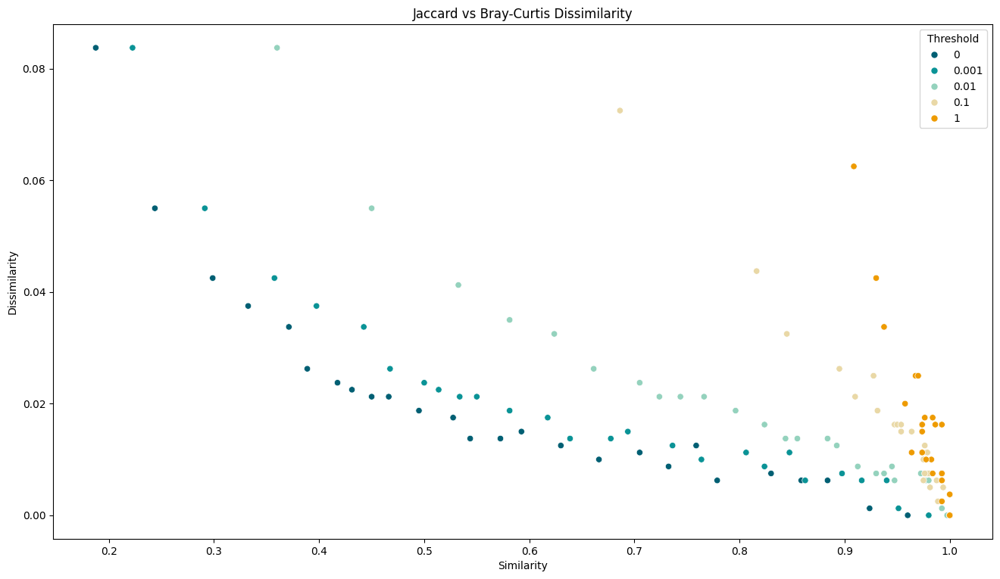

In [18]:
df = final_df
thresholds = ['0', '0.001', '0.01', '0.1', '1']
COLORS = ["#005f73", "#0a9396", "#94d2bd", "#e9d8a6", "#ee9b00", "#ca6702", "#bb3e03", "#ae2012", "#9b2226"]
# Create a color palette that corresponds to each threshold
palette = dict(zip(thresholds, COLORS))

plt.figure(figsize=(16, 9), dpi=100)
scatter_plot = sns.scatterplot(data=df, x='Ground_truth', y='Dissimilarity', hue='threshold', palette=palette)

plt.xlabel('Similarity')
plt.ylabel('Dissimilarity')
plt.title('Jaccard vs Bray-Curtis Dissimilarity')

# Remove the default legend
scatter_plot.get_legend().remove()


# Create custom legend with dots
legend_dots = [mlines.Line2D([], [], color=palette[thresh], marker='o', linestyle='None', markersize=5, label=thresh) for thresh in thresholds]
plt.legend(handles=legend_dots, title='Threshold')

plt.show()



This section for predict n components by cluster with Gaussian method 

In [33]:
from sklearn.mixture import GaussianMixture

df_ = final_df.drop(['index'],axis=1)
n_components = np.arange(1, 11)
models = [GaussianMixture(n, covariance_type='full', random_state=0).fit(df_) for n in n_components]

plt.figure(figsize=(10, 6), dpi =1200)
        
plt.plot(n_components, [m.bic(df_) for m in models], label='BIC', marker='o', color= "#e9d8a6")
plt.plot(n_components, [m.aic(df_) for m in models], label='AIC', marker='o', color= "#005f73")
plt.legend(loc='best')
plt.xlabel('Number of components')
plt.ylabel('Information Criterion')
plt.title('BIC & AIC for GMM')
plt.show()


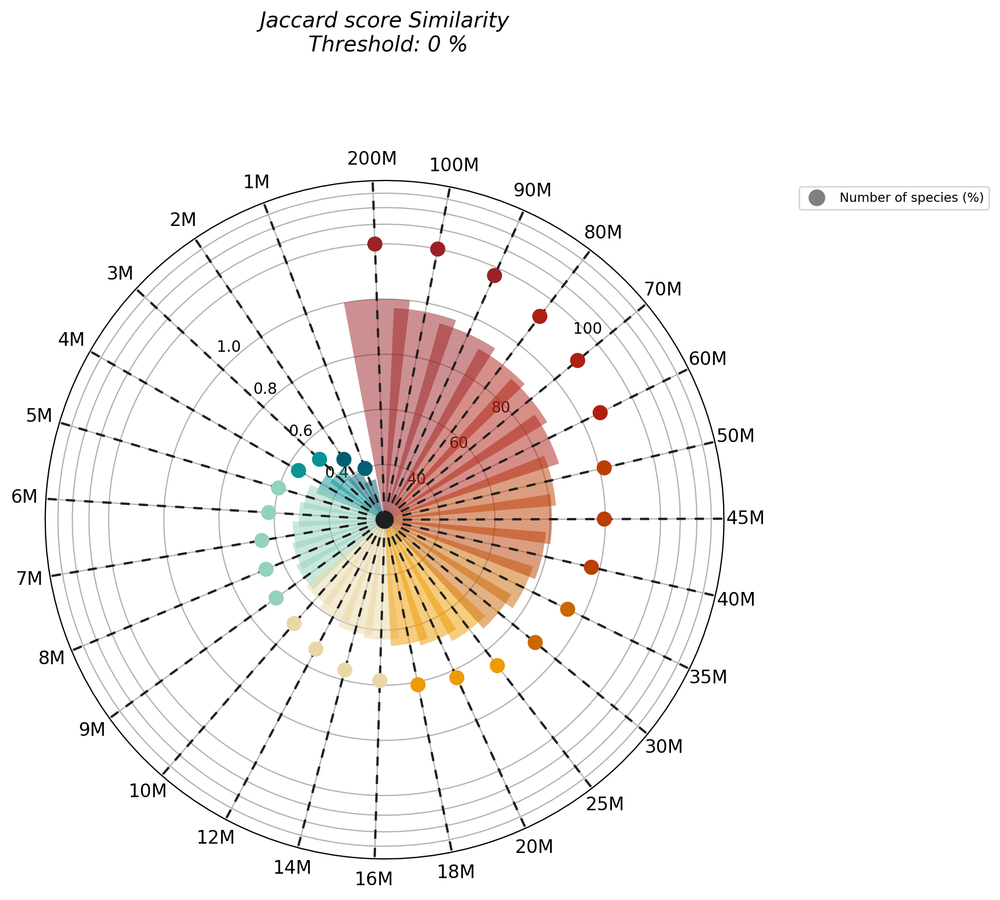

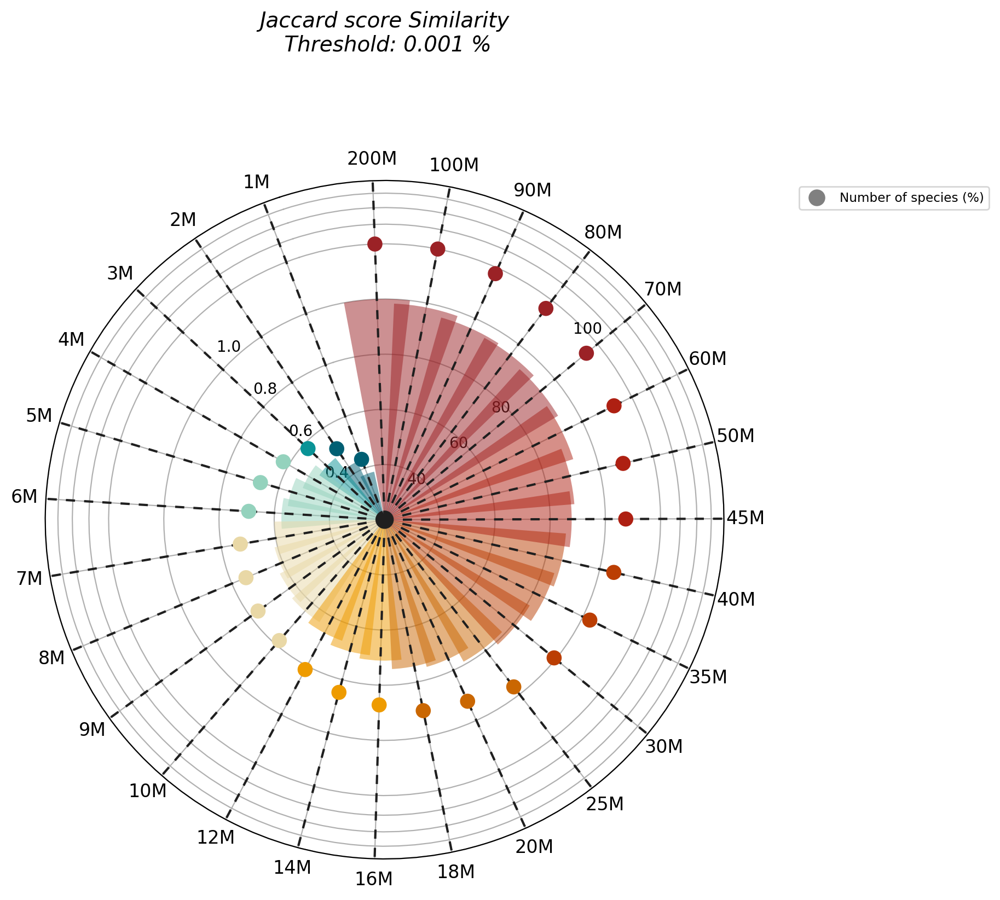

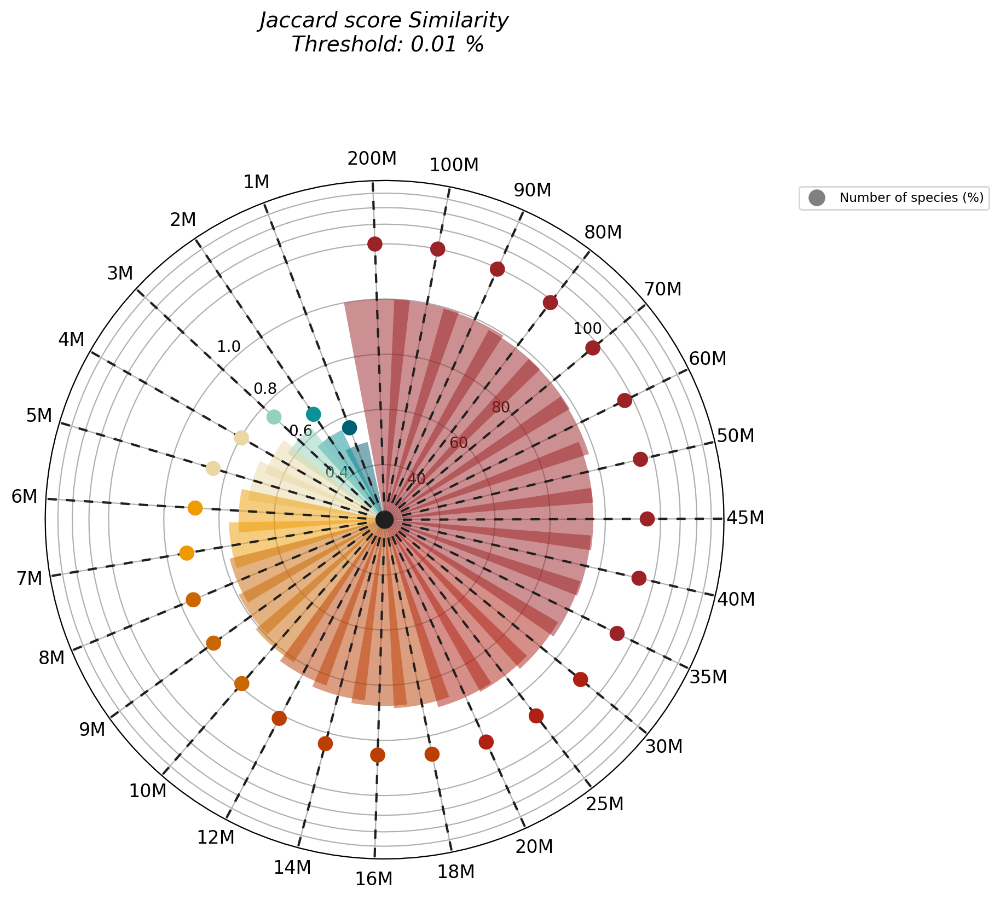

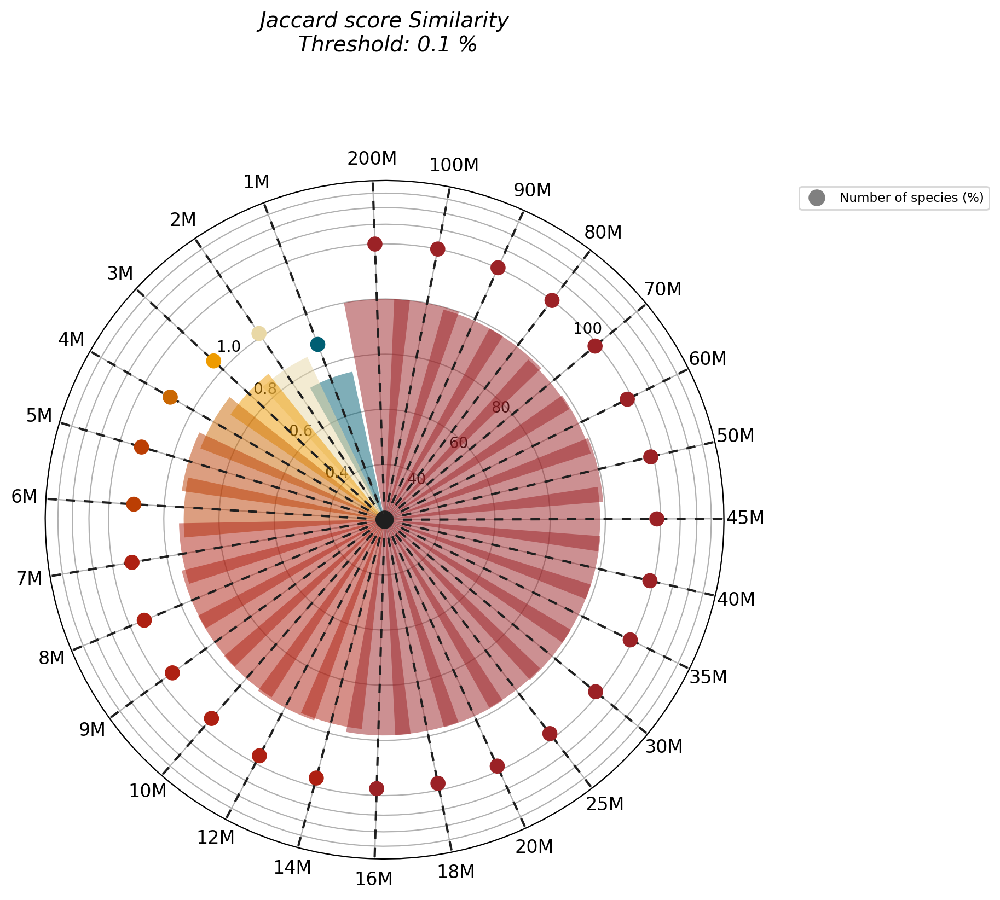

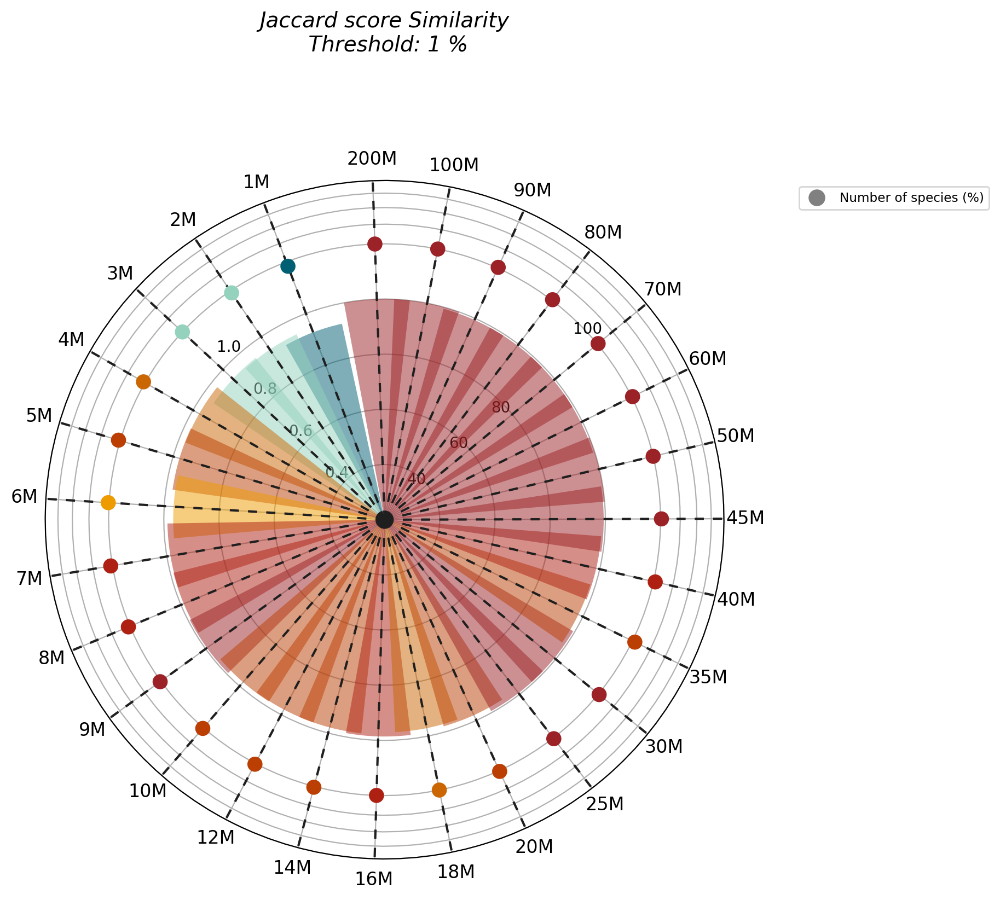

In [19]:
# Assuming final_df_split is your DataFrame
thresholds = ['0', '0.001', '0.01', '0.1', '1']
COLORS = ["#005f73", "#0a9396", "#94d2bd", "#e9d8a6", "#ee9b00", "#ca6702", "#bb3e03", "#ae2012", "#9b2226"]
cmap = mpl.colors.LinearSegmentedColormap.from_list("my color", COLORS, N=9)

for thresh in thresholds:
    df_thresh = df[df['threshold'] == thresh]

    if df_thresh.empty:
        print(f"No data available for threshold {thresh}")
        continue

    # Normalizer for colors
    NUMBERS = df_thresh['Ground_truth'].values
    norm = mpl.colors.Normalize(vmin=NUMBERS.min(), vmax=NUMBERS.max())
    COLORS = cmap(norm(NUMBERS))

    # Initialize layout in polar coordinates
    fig, ax = plt.subplots(figsize=(8, 16), subplot_kw={"projection": "polar"}, dpi=200)
    fig.patch.set_facecolor("white")
    ax.set_facecolor("white")

    ax.set_theta_offset(1.2 * np.pi / 2)
    min_ground_truth = df_thresh['Ground_truth'].min()
    max_ground_truth = df_thresh['Species_mean'].max()
    ax.set_ylim(min_ground_truth, max_ground_truth)
    ax.set_yscale('symlog', linthresh=100)

    # Set the y-ticks and customize the labels
    y_ticks = np.linspace(min_ground_truth, max_ground_truth, 11)
    ax.set_rticks(y_ticks)
    ax.set_yticklabels(np.around(np.linspace(0, 1, len(y_ticks)), 1))
    ax.set_rlabel_position(22)
    ax.set_yticklabels([])

    # Add bars for 'Ground_truth'
    ANGLES = np.linspace(0.05, 2 * np.pi - 0.05, len(df_thresh), endpoint=False)
    LENGTHS = df_thresh['Ground_truth'].values * 80
    ax.bar(ANGLES, LENGTHS, color=COLORS, alpha=0.5, width=0.3, zorder=11, label='Jaccard-index similarity score')

    # Add dashed vertical lines
    ax.vlines(ANGLES, 0, 200, color="#1f1f1f", ls=(0, (4, 4)), zorder=11)

    # Add dots for 'Species_mean'
    MEAN_GAIN = df_thresh['Species_mean'].values
    ax.scatter(ANGLES, MEAN_GAIN, s=80, color=COLORS, zorder=11, label='Species counts')

    # Add labels for the regions
    REGION = ["\n".join(wrap(r, 5, break_long_words=False)) for r in df_thresh['index'].values]
    ax.set_xticks(ANGLES)
    ax.set_xticklabels(REGION, size=12)
    ax.set_yticks(np.arange(0, 200, step=20))

    # Add custom legend
    legend_elements = [Line2D([0], [0], marker='o', color='w', label='Number of species (%)', markerfacecolor='gray', markersize=12)]
    ax.legend(handles=legend_elements, loc='upper right', bbox_to_anchor=(1.4, 1), fontsize='small')
    
    # Add scale starting at 1M and ending at 45M
    PAD = 10
    ax.text(-0.75 * np.pi / 2, 10 + PAD, "40", ha="right", size=10)
    ax.text(-0.75 * np.pi / 2, 30 + PAD, "60", ha="right", size=10)
    ax.text(-0.75 * np.pi / 2, 50 + PAD, "80", ha="right", size=10)
    ax.text(-0.75 * np.pi / 2, 100 + PAD, "100", ha="right", size=10)

    ax.text(0.25 * np.pi / 2, 10 + PAD, "0.4", ha="right", size=10)
    ax.text(0.25 * np.pi / 2, 30 + PAD, "0.6", ha="right", size=10)
    ax.text(0.25 * np.pi / 2, 50 + PAD, "0.8", ha="right", size=10)
    ax.text(0.25 * np.pi / 2, 70 + PAD, "1.0", ha="right", size=10)

    # Add title and subtile at the top of the chart
    plt.title(f'Jaccard score Similarity\n Threshold: {thresh} %', style='italic', size=14, pad=85)

    # Display the chart
    plt.show()


Snail graph for bray-curtis type tresh 

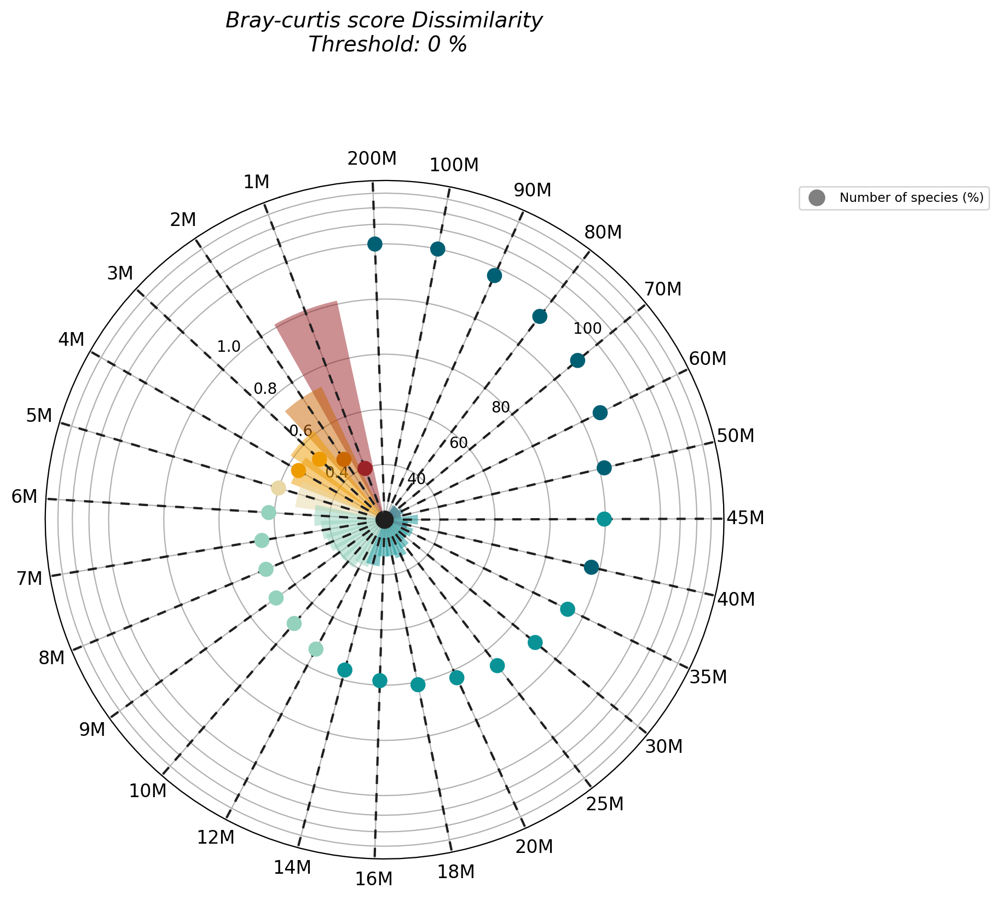

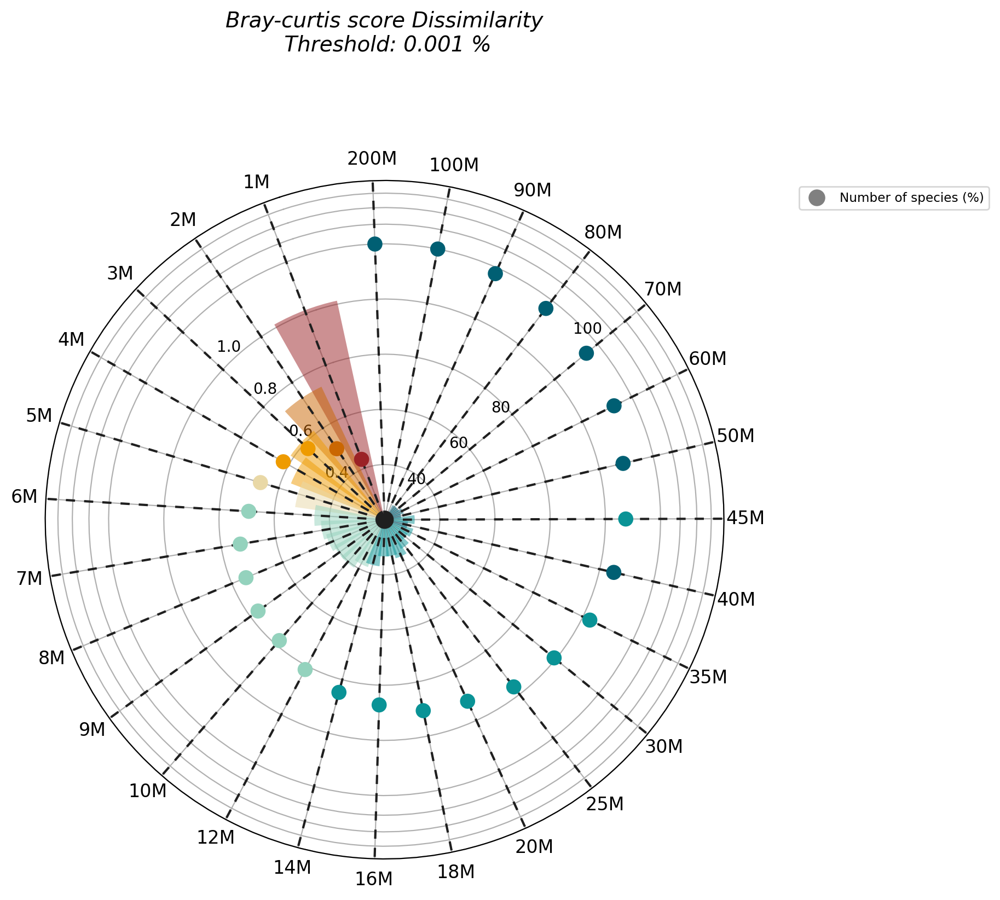

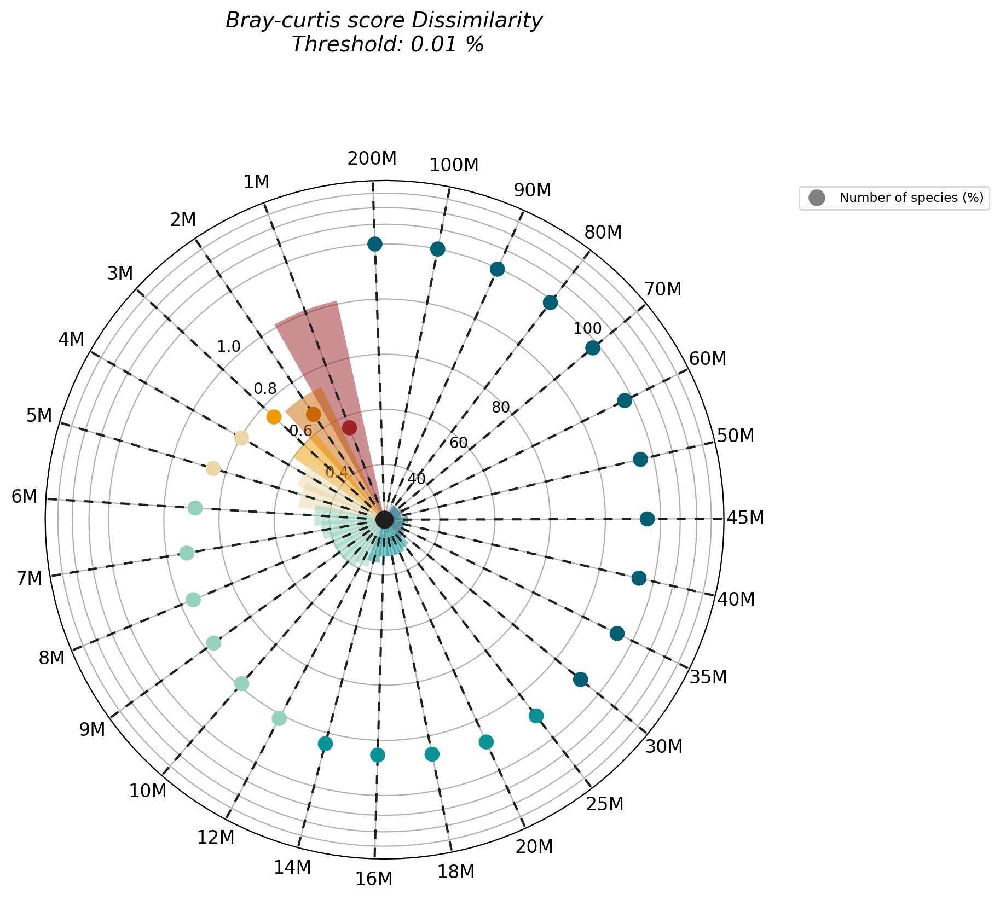

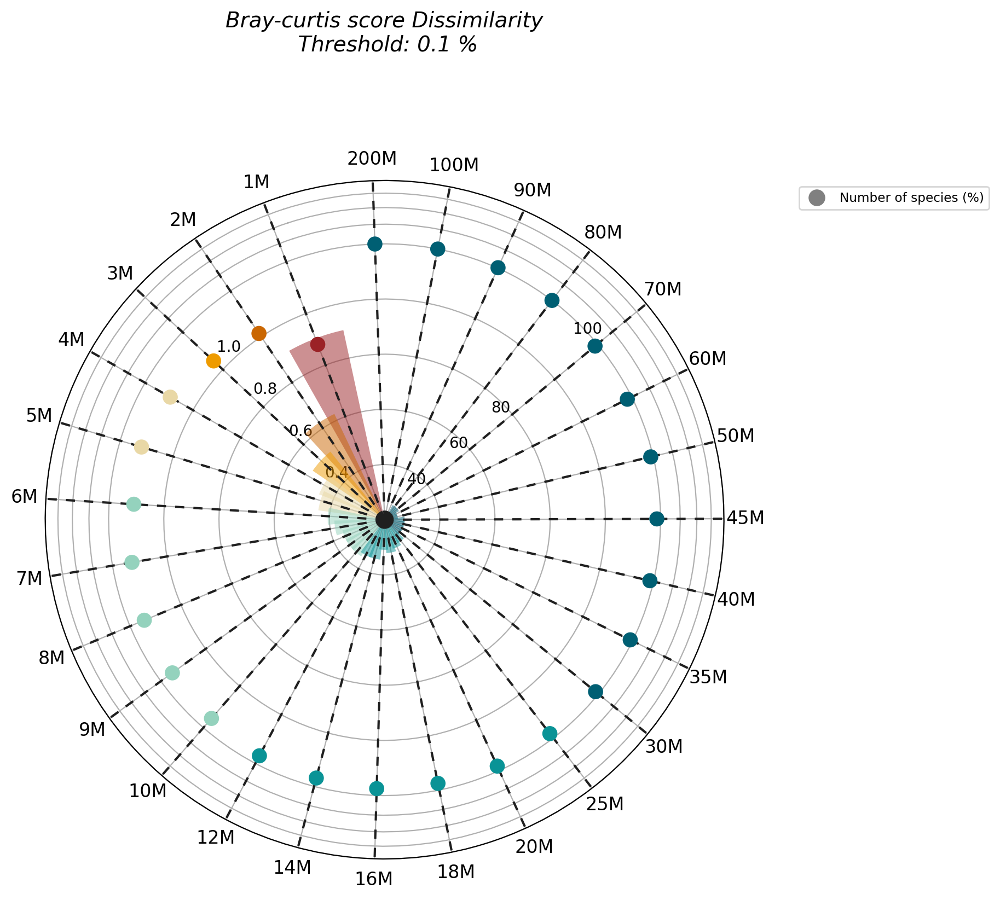

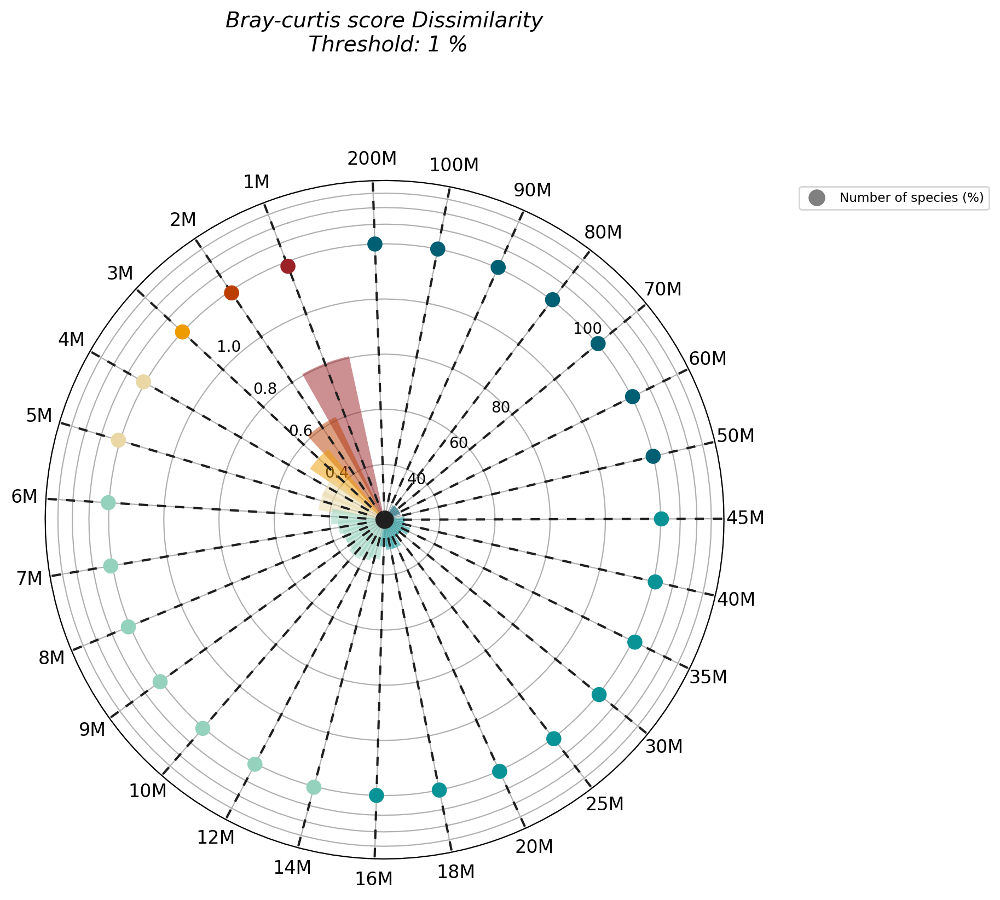

In [20]:
# Assuming final_df_split is your DataFrame
df = final_df
thresholds = ['0', '0.001', '0.01', '0.1', '1']
COLORS = ["#005f73", "#0a9396", "#94d2bd", "#e9d8a6", "#ee9b00", "#ca6702", "#bb3e03", "#ae2012", "#9b2226"]
# Assuming final_df is your DataFrame
cmap = mpl.colors.LinearSegmentedColormap.from_list("my color", COLORS, N=9)

for thresh in thresholds:
    df_thresh = df[df['threshold'] == thresh]

    if df_thresh.empty:
        print(f"No data available for threshold {thresh}")
        continue

    # Normalizer for colors
    NUMBERS = df_thresh['Dissimilarity'].values
    norm = mpl.colors.Normalize(vmin=NUMBERS.min(), vmax=NUMBERS.max())
    COLORS = cmap(norm(NUMBERS))

    # Initialize layout in polar coordinates
    fig, ax = plt.subplots(figsize=(8, 16), subplot_kw={"projection": "polar"}, dpi=200)
    fig.patch.set_facecolor("white")
    ax.set_facecolor("white")

    ax.set_theta_offset(1.2 * np.pi / 2)
    min_ground_truth = df_thresh['Dissimilarity'].min()
    max_ground_truth = df_thresh['Species_mean'].max()
    ax.set_ylim(min_ground_truth, max_ground_truth)
    ax.set_yscale('symlog', linthresh=100)

    # Set the y-ticks and customize the labels
    y_ticks = np.linspace(min_ground_truth, max_ground_truth, 11)
    ax.set_rticks(y_ticks)
    ax.set_yticklabels(np.around(np.linspace(0, 1, len(y_ticks)), 1))
    ax.set_rlabel_position(22)
    ax.set_yticklabels([])

    # Add bars for 'Ground_truth'
    ANGLES = np.linspace(0.05, 2 * np.pi - 0.05, len(df_thresh), endpoint=False)
    LENGTHS = df_thresh['Dissimilarity'].values * 970
    ax.bar(ANGLES, LENGTHS, color=COLORS, alpha=0.5, width=0.3, zorder=11, label='Bray-curtis Dissimilarity score')

    # Add dashed vertical lines
    ax.vlines(ANGLES, 0, 200, color="#1f1f1f", ls=(0, (4, 4)), zorder=11)

    # Add dots for 'Species_mean'
    MEAN_GAIN = df_thresh['Species_mean'].values
    ax.scatter(ANGLES, MEAN_GAIN, s=80, color=COLORS, zorder=11, label='Species counts')

    # Add labels for the regions
    REGION = ["\n".join(wrap(r, 5, break_long_words=False)) for r in df_thresh['index'].values]
    ax.set_xticks(ANGLES)
    ax.set_xticklabels(REGION, size=12)
    ax.set_yticks(np.arange(0, 200, step=20))

    # Add custom legend
    legend_elements = [Line2D([0], [0], marker='o', color='w', label='Number of species (%)', markerfacecolor='gray', markersize=12)]
    ax.legend(handles=legend_elements, loc='upper right', bbox_to_anchor=(1.4, 1), fontsize='small')
    
    # Add scale starting at 1M and ending at 45M
    PAD = 10
    ax.text(-0.75 * np.pi / 2, 10 + PAD, "40", ha="right", size=10)
    ax.text(-0.75 * np.pi / 2, 30 + PAD, "60", ha="right", size=10)
    ax.text(-0.75 * np.pi / 2, 50 + PAD, "80", ha="right", size=10)
    ax.text(-0.75 * np.pi / 2, 100 + PAD, "100", ha="right", size=10)

    ax.text(0.25 * np.pi / 2, 10 + PAD, "0.4", ha="right", size=10)
    ax.text(0.25 * np.pi / 2, 30 + PAD, "0.6", ha="right", size=10)
    ax.text(0.25 * np.pi / 2, 50 + PAD, "0.8", ha="right", size=10)
    ax.text(0.25 * np.pi / 2, 70 + PAD, "1.0", ha="right", size=10)

    # Add title and subtile at the top of the chart
    plt.title(f'Bray-curtis score Dissimilarity\n Threshold: {thresh} %', style='italic', size=14, pad=85)

    # Display the chart
    plt.show()
